# Домашнее задание 

В этом задании мы попрактикуемся в методах снижения размерности и кластеризации данных. 

## Задание 1. Кластеризация типов движений (5 баллов)

В этой части задания мы будем работать с набором данных Samsung Human Activity Recognition. Скачайте данные по ссылке https://yadi.sk/d/_WFxgSIuBF06Rg. Данные поступают с акселерометров и гироскопов мобильных телефонов Samsung Galaxy S3, также известен вид активности человека с телефоном в кармане – ходил ли он, стоял, лежал, сидел или шел вверх/вниз по лестнице.

Представим, что вид активности нам неизвестнен, и попробуем кластеризовать людей чисто на основе имеющихся признаков.

Также есть методичка/овервью от sklearn:
[Методичка](https://scikit-learn.org/stable/modules/clustering.html#clustering-performance-evaluation)

In [244]:
import numpy as np
import pandas as pd
import seaborn as sns
from matplotlib import pyplot as plt


plt.style.use(['seaborn-darkgrid'])
plt.rcParams['figure.figsize'] = (12, 9)
plt.rcParams['font.family'] = 'DejaVu Sans'

%matplotlib inline
%config InlineBackend.figure_format="retina"

RANDOM_STATE = 42

C:\Users\grace\AppData\Local\Temp\ipykernel_17840\3727277117.py:7: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use(['seaborn-darkgrid'])


### Задание 1.0 (0.1 балл)
Прочитайте данные из файлов и объедните тестовую и обучающие выборки.

В файлах ```..._labels``` лежат настоящие классы. Их также объедините, но в отдельную переменную (например ```y```). Данный вектор для кластеризации нам не нужен, но мы будем смотреть по нему метрики.

In [245]:
#your code here
X_train = pd.read_csv('./samsung_HAR/samsung_train.txt', usecols=range(662), sep=" ", header=None, on_bad_lines='warn')
X_test = pd.read_csv('./samsung_HAR/samsung_test.txt', usecols=range(662), sep=" ", header=None, on_bad_lines='warn')

In [246]:
X_train.shape

(7352, 662)

In [247]:
X_train.describe

<bound method NDFrame.describe of       0    1         2         3         4         5         6         7    \
0     NaN  NaN  0.288585 -0.020294 -0.132905 -0.995279 -0.983111 -0.913526   
1     NaN  NaN  0.278419 -0.016411 -0.123520 -0.998245 -0.975300 -0.960322   
2     NaN  NaN  0.279653 -0.019467 -0.113462 -0.995380 -0.967187 -0.978944   
3     NaN  NaN  0.279174 -0.026201 -0.123283 -0.996091 -0.983403 -0.990675   
4     NaN  NaN  0.276629 -0.016570 -0.115362 -0.998139 -0.980817 -0.990482   
...   ...  ...       ...       ...       ...       ...       ...       ...   
7347  NaN  NaN  0.299665 -0.057193 -0.181233 -0.195387       NaN  0.039905   
7348  NaN  NaN  0.273853 -0.007749 -0.147468 -0.235309       NaN  0.004816   
7349  NaN  NaN  0.273387 -0.017011 -0.045022 -0.218218 -0.103822       NaN   
7350  NaN  NaN  0.289654 -0.018843 -0.158281 -0.219139 -0.111412       NaN   
7351  NaN  NaN  0.351503 -0.012423 -0.203867 -0.269270 -0.087212       NaN   

           8         9    ...

In [248]:
X_test.shape

(2947, 662)

In [249]:
X_test.describe

<bound method NDFrame.describe of       0    1         2         3         4         5         6         7    \
0     NaN  NaN  0.257178 -0.023285 -0.014654 -0.938404 -0.920091 -0.667683   
1     NaN  NaN  0.286027 -0.013163 -0.119083 -0.975415 -0.967458 -0.944958   
2     NaN  NaN  0.275485 -0.026050 -0.118152 -0.993819 -0.969926 -0.962748   
3     NaN  NaN  0.270298 -0.032614 -0.117520 -0.994743 -0.973268 -0.967091   
4     NaN  NaN  0.274833 -0.027848 -0.129527 -0.993852 -0.967445 -0.978295   
...   ...  ...       ...       ...       ...       ...       ...       ...   
2942  NaN  NaN  0.310155 -0.053391 -0.099109 -0.287866 -0.140589 -0.215088   
2943  NaN  NaN  0.363385 -0.039214 -0.105915 -0.305388       NaN  0.028148   
2944  NaN  NaN  0.349966       NaN  0.030077 -0.115788 -0.329638 -0.042143   
2945  NaN  NaN  0.237594       NaN  0.018467 -0.096499 -0.323114 -0.229775   
2946  NaN  NaN  0.153627 -0.018437 -0.137018 -0.330046 -0.195253 -0.164339   

           8         9    ...

In [250]:
# combine train and test DF-s so we can transform them together
X = X_train.append(X_test)
X.shape

C:\Users\grace\AppData\Local\Temp\ipykernel_17840\1806059112.py:2: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  X = X_train.append(X_test)


(10299, 662)

In [251]:
# now let's read and merge labels
y_train = pd.read_csv('./samsung_HAR/samsung_train_labels.txt', sep=" ", header=None, on_bad_lines='warn')
y_test = pd.read_csv('./samsung_HAR/samsung_test_labels.txt', sep=" ", header=None, on_bad_lines='warn')

y = y_train.append(y_test)
y.shape

C:\Users\grace\AppData\Local\Temp\ipykernel_17840\787279729.py:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  y = y_train.append(y_test)


(10299, 1)

In [252]:
np.unique(y)

array([1, 2, 3, 4, 5, 6], dtype=int64)

Эти метки соответствуют:

1 - ходьбе,
2 - подъему вверх по лестнице,
3 - спуску по лестнице,
4 - сидению,
5 - стоянию,
6 - лежанию

### Задание 1.1 (0.5 баллов)

Отмасштабируйте выборку с помощью ```StandardScaler```.

[Документация](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html)

In [253]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(X)
X_scaled = scaler.transform(X)

C:\Users\grace\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\utils\extmath.py:981: RuntimeWarning: invalid value encountered in divide
  updated_mean = (last_sum + new_sum) / updated_sample_count
C:\Users\grace\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\utils\extmath.py:986: RuntimeWarning: invalid value encountered in divide
  T = new_sum / new_sample_count
C:\Users\grace\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\utils\extmath.py:1006: RuntimeWarning: invalid value encountered in divide
  new_unnormalized_variance -= correction**2 / new_sample_count


### Задание 1.2 (0.6 баллов)

Понизьте размерность с помощью ```PCA```, оставляя столько компонент, сколько нужно для того, чтобы объяснить как минимум 90% дисперсии отмасштабированных данных. ```random_state``` используйте из объявленной в самом начале переменной ```RANDOM_STATE``` (42).

[Документация](https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html)

In [254]:
from sklearn.decomposition import PCA
from sklearn.impute import SimpleImputer

# first, let's impute missing values so PCA could work with our data
imp_mean = SimpleImputer(missing_values=np.nan, strategy='mean')
imp_mean.fit(X_scaled)
X_scaled_imputed = imp_mean.transform(X_scaled)

# run a draft PCA fit/transform to analyze the explained varience
pca = PCA(n_components=scaler.n_features_in_ - 1, random_state=RANDOM_STATE)
pca.fit_transform(X_scaled_imputed)

number_of_components_to_keep = 0

for explained_variance in pca.explained_variance_ratio_.cumsum():
    number_of_components_to_keep = number_of_components_to_keep + 1
    
    if explained_variance >= 0.9:
        print("Number of components to keep: " + str(number_of_components_to_keep))
        break

# final PCA fit/transform
pca = PCA(n_components=number_of_components_to_keep, random_state=RANDOM_STATE)
X_pca = pca.fit_transform(X_scaled_imputed)

Number of components to keep: 342


### Задание 1.3 (0.3 баллов)

Визуализируйте данные в проекции на первые две главные компоненты. Используйте ```cmap="virdis"``` или любой другой, с которым будет красиво :)

C:\Users\grace\AppData\Local\Temp\ipykernel_17840\292012478.py:2: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(X_pca[:,0],X_pca[:,1], cmap='viridis')


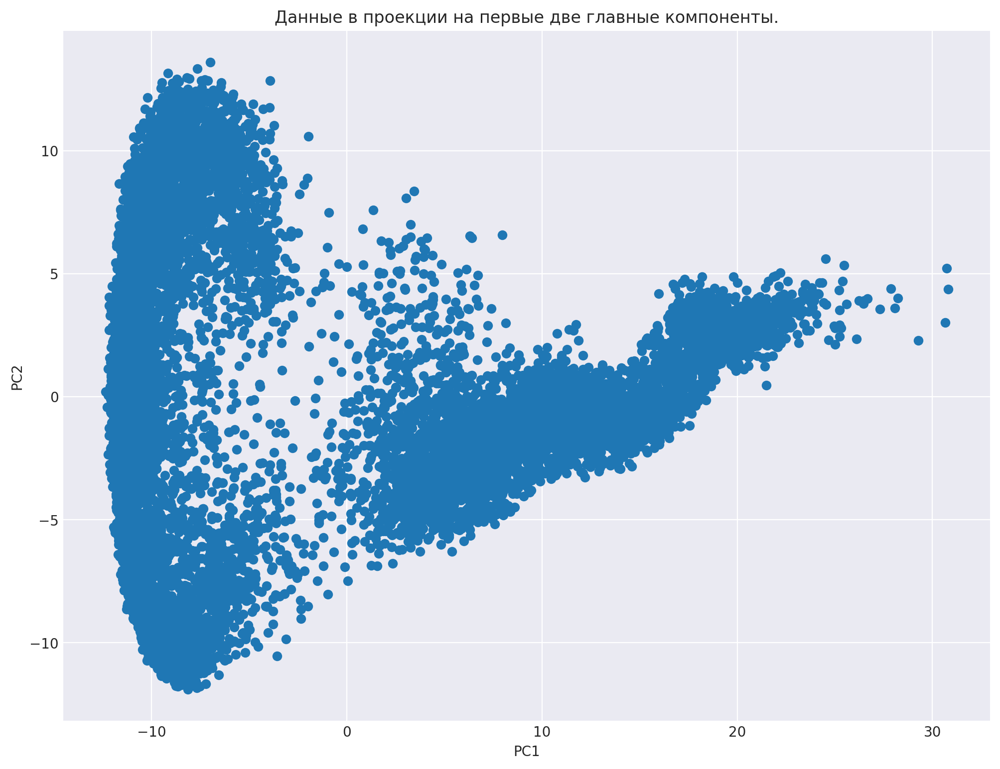

In [255]:
# your code here
plt.scatter(X_pca[:,0],X_pca[:,1], cmap='viridis')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.title('Данные в проекции на первые две главные компоненты.')
plt.show()

### Задание 1.4 (0.4 балла)

Сделайте кластеризацию данных методом ```KMeans```, обучив модель на данных со сниженной за счет ```PCA```
размерностью. В данном случае нужно искать 6 кластеров (изначально у нас 6 классов). Засеките время обучения и время инференса.

Параметры:

```n_clusters = 6``` (число уникальных меток целевого класса = 6)

```n_init = 100```

```random_state = RANDOM_STATE``` (для воспроизводимости результата, не забывайте указывать его и дальше!)

[Документация](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html)

In [256]:
from sklearn.cluster import KMeans
import time

# Fit
start = time.time()
kmeans = KMeans(n_clusters=6, random_state=RANDOM_STATE, n_init=100)
kmeans.fit(X_pca)
end = time.time()
print("Fit time: " + str(end - start))

# Predict
start = time.time()
prediction = kmeans.predict(X_pca)
end = time.time()
print("Predict time: " + str(end - start))


Fit time: 10.621108293533325
Predict time: 0.02628302574157715


### Задание 1.5 (0.2 балла)

Визуализируйте данные в проекции на первые две главные компоненты. Раскрасьте точки в соответствии с полученными метками кластеров.

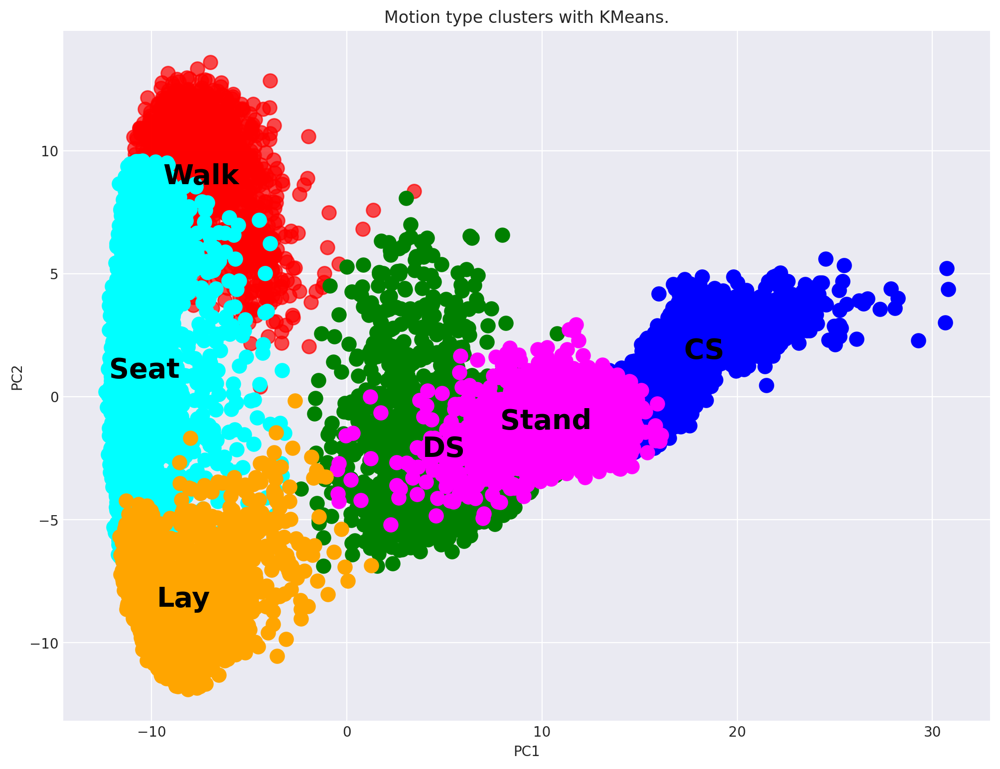

In [257]:
def plot_clusters(prediction, title):
    plt.scatter(X_pca[prediction==0, 0], X_pca[prediction==0, 1], s=100, c='red', label ='Walk',  alpha=0.7)
    plt.annotate(
        'Walk',
        (X_pca[prediction==0, 0].mean(), X_pca[prediction==0, 1].mean()),
        horizontalalignment='center', verticalalignment='center', size=20, weight='bold', color='black')
    
    plt.scatter(X_pca[prediction==1, 0], X_pca[prediction==1, 1], s=100, c='blue', label ='Climb stairs')
    plt.annotate(
        'CS',
        (X_pca[prediction==1, 0].mean(), X_pca[prediction==1, 1].mean()),
        horizontalalignment='center', verticalalignment='center', size=20, weight='bold', color='black')
    
    plt.scatter(X_pca[prediction==2, 0], X_pca[prediction==2, 1], s=100, c='green', label ='Walk down the stairs')
    plt.annotate(
        'DS',
        (X_pca[prediction==2, 0].mean(), X_pca[prediction==2, 1].mean()),
        horizontalalignment='center', verticalalignment='center', size=20, weight='bold', color='black')
    
    plt.scatter(X_pca[prediction==3, 0], X_pca[prediction==3, 1], s=100, c='cyan', label ='Seat')
    plt.annotate(
        'Seat',
        (X_pca[prediction==3, 0].mean(), X_pca[prediction==3, 1].mean()),
        horizontalalignment='center', verticalalignment='center', size=20, weight='bold', color='black')
    
    plt.scatter(X_pca[prediction==4, 0], X_pca[prediction==4, 1], s=100, c='magenta', label ='Stand')
    plt.annotate(
        'Stand',
        (X_pca[prediction==4, 0].mean(), X_pca[prediction==4, 1].mean()),
        horizontalalignment='center', verticalalignment='center', size=20, weight='bold', color='black')
    
    plt.scatter(X_pca[prediction==5, 0], X_pca[prediction==5, 1], s=100, c='orange', label ='Lay')
    plt.annotate(
        'Lay',
        (X_pca[prediction==5, 0].mean(), X_pca[prediction==5, 1].mean()),
        horizontalalignment='center', verticalalignment='center', size=20, weight='bold', color='black')
    

    plt.title(title)
    plt.xlabel('PC1')
    plt.ylabel('PC2')
    plt.show()

plot_clusters(prediction, "Motion type clusters with KMeans.")

### Задание 1.6 (0.3 баллов)

Выберите какие-то метрики (минимум две) из известных вам или из методички (ссылка в начале дз, пункт 2.3.10), объясните ваш выбор.

Выведите на экран значения метрик качества кластеризации и используйте их далее.

In [258]:
from sklearn import metrics

def calculate_quality_metrics(prediction):
    print("Rand score: " + str(metrics.rand_score(y[0], prediction)))
    print("Adjusted mutual info score: " + str(metrics.adjusted_mutual_info_score(y[0], prediction)))
    print("Fowlkes-Mallows score: " + str(metrics.fowlkes_mallows_score(y[0], prediction)))
    
calculate_quality_metrics(prediction)

Rand score: 0.7858292822430271
Adjusted mutual info score: 0.404831362463015
Fowlkes-Mallows score: 0.3717711253464639


Поскольку у нас есть метки с ответами, мы можем использовать внешние меры: rand index, adjusted rand index и т.д. Эти меры легко интерпретировать. RI и ARI не делают предположений о структуре кластера и могут применяться ко всем алгоритмам кластеризации.

Кроме того, я мало знаю о структуре кластера, поэтому мы можем использовать Fowlkes-Mallows score. Эта оценка не делает предположений о структуре кластера и может применяться ко всем алгоритмам кластеризации. Fowlkes-Mallows score имеет верхнюю границу 1. Ограниченный диапазон позволяет легко сравнивать оценки между различными алгоритмами.

### Задание 1.7 (0.8 баллов)
Теперь попробуем сделать кластеризацию с помощью ```AgglomerativeClustering```.

Вновь визуализируйте данные с раскраской по полученным меткам и выведите метрики. Засеките время обучения и время инференса. Сравните с ```KMeans```.

Ответьте на следующие вопросы:
* Стало ли лучше?
* Почему?

[Документация](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.AgglomerativeClustering.html)

In [259]:
from sklearn.cluster import AgglomerativeClustering

# Fit/predict for AgglomerativeClustering
start = time.time()
agg_clustering = AgglomerativeClustering(n_clusters=6)
agg_prediction = agg_clustering.fit_predict(X_pca)
end = time.time()
print("Fit/predict time: " + str(end - start))


Fit/predict time: 22.281861782073975


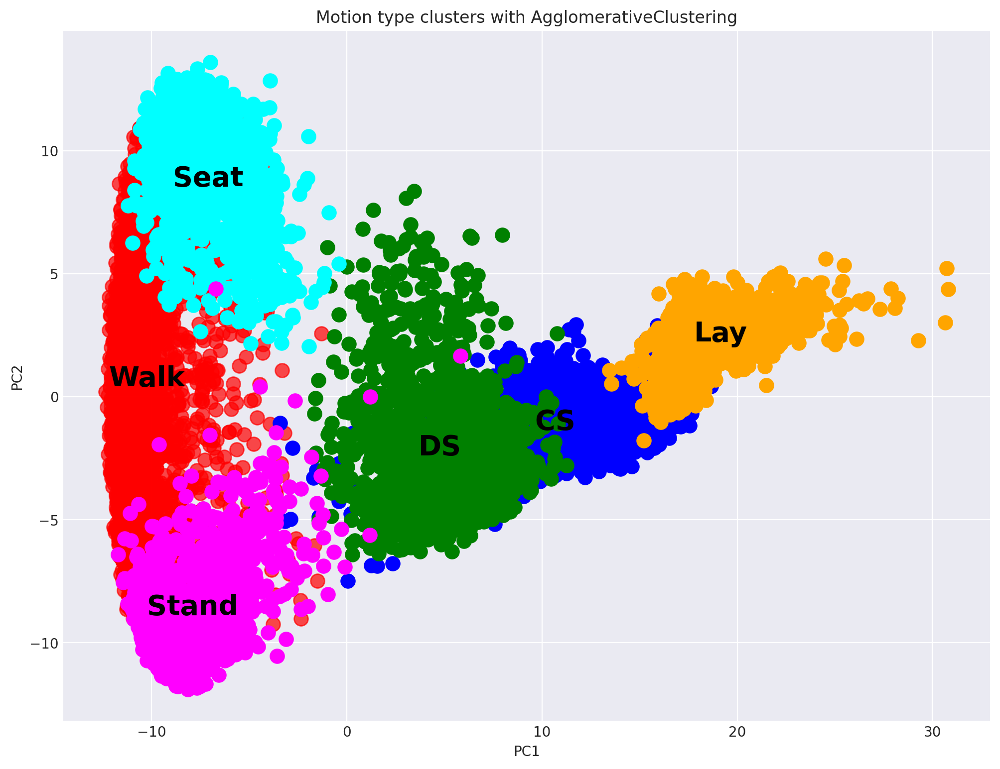

In [260]:
plot_clusters(agg_prediction, 'Motion type clusters with AgglomerativeClustering')

In [261]:
calculate_quality_metrics(agg_prediction)

Rand score: 0.7777404903918572
Adjusted mutual info score: 0.41186721161584355
Fowlkes-Mallows score: 0.38429635859931077


Что интересно, позиции наших кастеров изменились. Теперь это имеет больше смысла. Подъем по лестнице находится рядом со спуском по лестнице, стоять рядом с идти.

Глядя на оценки, не похоже, что мы наблюдаем значительное улучшение при переходе с KMeans на AgglomerativeClustering. KMeans кажется более производительным. Требуется всего 10 секунд на fit/predict. Кроме того, с каждым новым наблюдением мы можем предсказать его кластер без повторного fit всей модели. С AgglomerativeClustering нам придется переобучить алгоритм со всеми данными, включая это новое наблюдение.

### Задание 1.8 (0.8 баллов)

Попробуйте применить другие методы кластеризации из sklearn.  Засеките время обучения и время инференса. Также вычислите метрики качества, визуализируйте результаты, после чего сделайте вывод о том, какой метод сработал лучше.

In [262]:
from sklearn.cluster import SpectralClustering

start = time.time()
spectral_clustering = SpectralClustering(n_clusters=6, gamma=1000).fit_predict(X_pca)
end = time.time()
print("SpectralClustering fit/predict time: " + str(end - start))

C:\Users\grace\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\sklearn\manifold\_spectral_embedding.py:259: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


SpectralClustering fit/predict time: 21.400434970855713


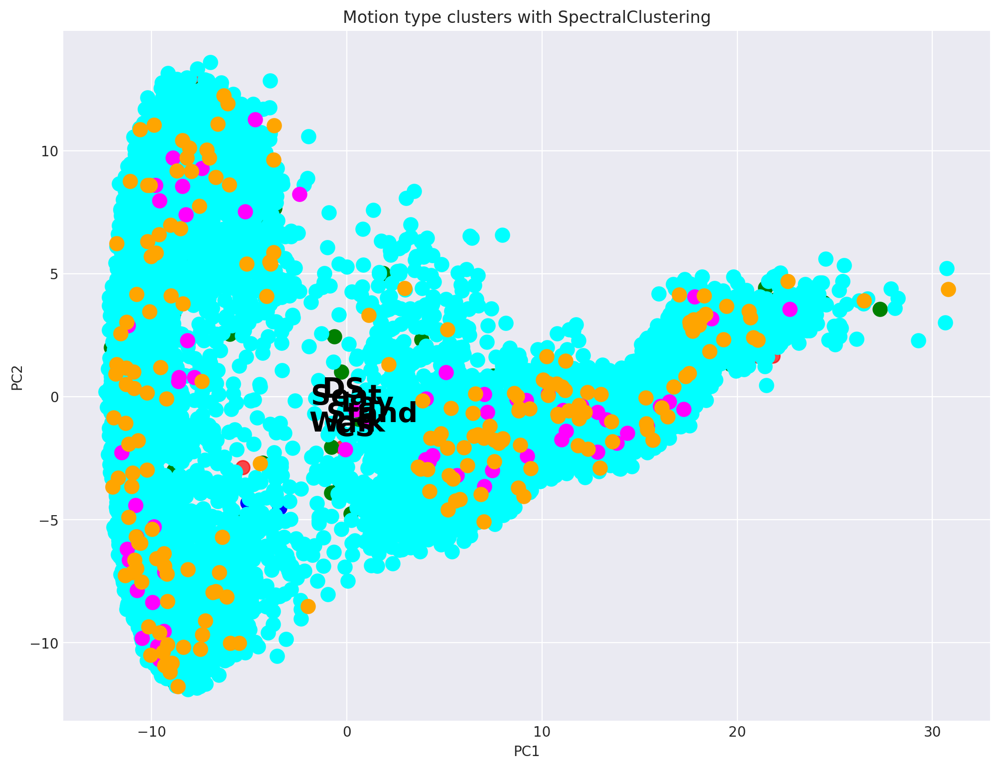

In [263]:
plot_clusters(spectral_clustering, "Motion type clusters with SpectralClustering")

In [264]:
calculate_quality_metrics(spectral_clustering)

Rand score: 0.24568972873257025
Adjusted mutual info score: -0.00027540184433468777
Fowlkes-Mallows score: 0.3862051099652353


In [265]:
from sklearn.cluster import Birch

start = time.time()
birch = Birch(n_clusters=6)
birch = birch.fit(X_pca)
birch_predictions = birch.predict(X_pca)
end = time.time()
print("BIRCH fit/predict time: " + str(end - start))

BIRCH fit/predict time: 25.631017684936523


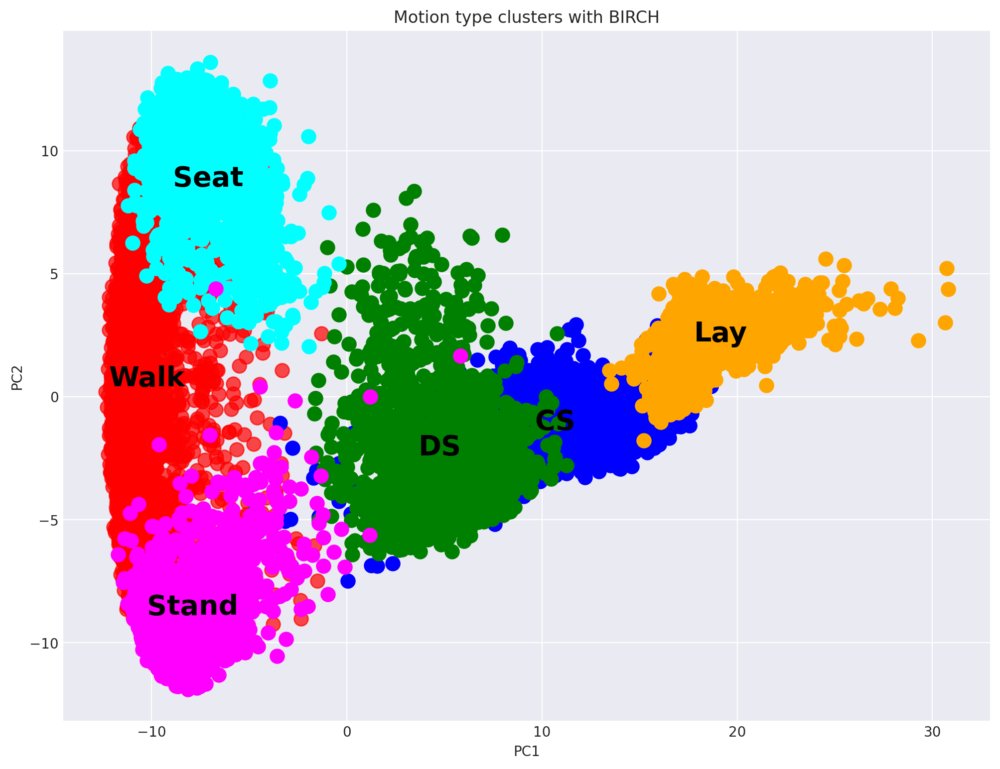

In [266]:
plot_clusters(birch_predictions, "Motion type clusters with BIRCH")

In [267]:
calculate_quality_metrics(birch_predictions)

Rand score: 0.7777404903918572
Adjusted mutual info score: 0.41186721161584355
Fowlkes-Mallows score: 0.38429635859931077


SpectralClustering провалил задание. На соответствующей диаграмме мы видим, что все кластеры слились воедино, границы не существуют. BIRCH, с другой стороны, неплохо справился.

### Задание 1.9 (1 балл)
Для самой успешной из полученных кластеризаций попробуйте дать интерпретацию кластеров. Опишите характеристики объектов, попавших в каждый кластер. Для этого можете ответить на следующие вопросы:

* Похожи ли объекты внутри каждого кластера на определенный тип активности человека?
* В каких кластерах смешано несколько типов активности? С чем, на ваш взгляд, это может быть связано?
* Качественная ли получилась кластеризация? На основании чего вы можете сделать такой вывод?

В моей серии экспериментов, кластеризация BIRCH показала наилучшие результаты:

Rand score: 0.7777404903918572

Adjusted mutual info score: 0.41186721161584355

Fowlkes-Mallows score: 0.38429635859931077

Из графика выше видно, что кластеры не четко разделены, а близко соседствуют друг с другом. Также они имеют вытянутую форму. Кластеры сгруппированы логично: подъем по лестнице находится рядом со спуском по лестнице, "стоять" рядом с "идти."

Некоторые виды деятельности смешаны вместе. Особенно похожие виды деятельности, такие как подъем/спуск по лестнице, стояние.

Мы можем использовать Parallel Coordinates Plot, чтобы увидеть, как отдельные точки данных соответствуют всем нашим переменным. На следующей диаграмме каждый цвет представляет отдельный кластер. Глядя на то, как значения переменных сравниваются по кластерам, мы можем понять, что на самом деле представляют собой кластеры.

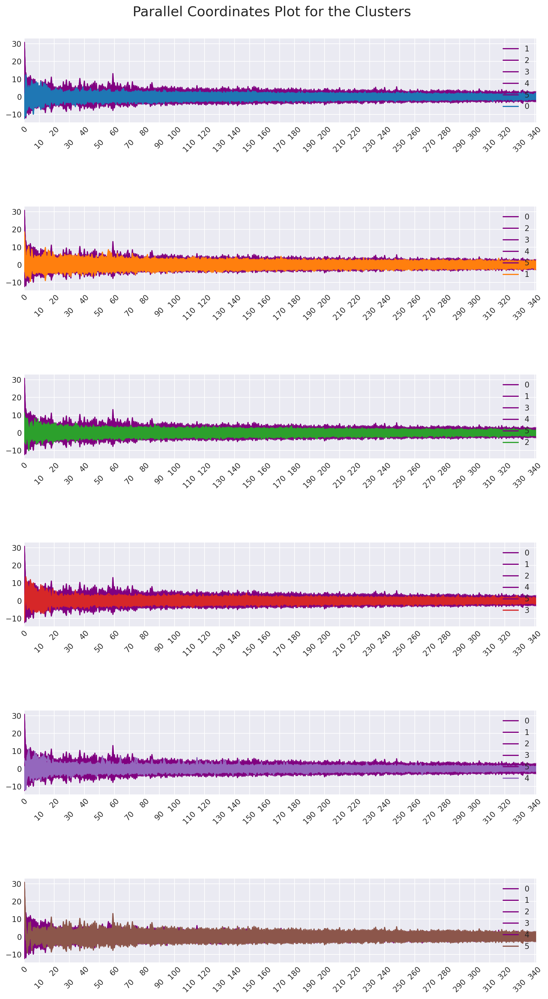

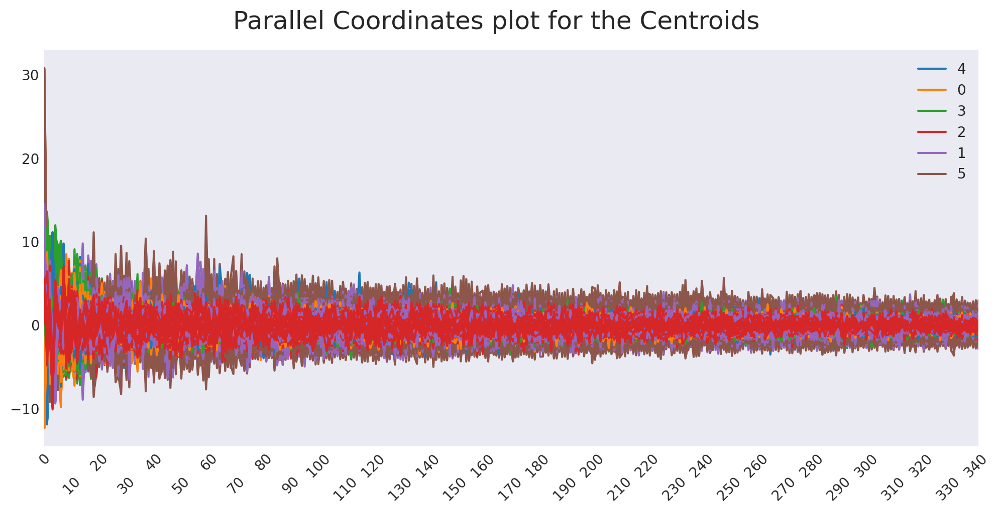

In [268]:
from pandas.plotting import parallel_coordinates
import matplotlib.colors as mcolors

palette = list(mcolors.TABLEAU_COLORS.keys())

# heavily inspired by https://github.com/OpenClassrooms-Student-Center/Multivariate-Exploratory-Analysis/blob/master/functions.py

def addAlpha(colour, alpha):
    return (colour[0],colour[1],colour[2],alpha)

def display_parallel_coordinates(df, num_clusters):
    # Select data points for individual clusters
    cluster_points = []
    for i in range(num_clusters):
        cluster_points.append(df[df.cluster==i])
    
    # Create the plot
    fig = plt.figure(figsize=(12, 20))
    fig.suptitle("Parallel Coordinates Plot for the Clusters", fontsize=18)
    fig.subplots_adjust(top=0.95, hspace=1)

    # Display one plot for each cluster, with the lines for the main cluster appearing over the lines for the other clusters
    for i in range(num_clusters):    
        plt.subplot(num_clusters, 1, i + 1)
        for j,c in enumerate(cluster_points):
            if i!= j:
                pc = parallel_coordinates(c, 'cluster', color=['purple'], axvlines=False)
        pc = parallel_coordinates(cluster_points[i], 'cluster', color=[palette[i]], axvlines=False)

        x = np.random.randint(low=-30, high=30, size=n_of_columns)
        plt.xticks(np.arange(0, len(x) + 1, 10))
        plt.xticks(rotation = 45)
        
        # Stagger the axes
        ax=plt.gca()
        for tick in ax.xaxis.get_major_ticks()[1::2]:
            tick.set_pad(20)

def display_parallel_coordinates_centroids(df):
    # Create the plot
    fig = plt.figure(figsize=(12, 5))
    fig.suptitle("Parallel Coordinates plot for the Centroids", fontsize=18)
    fig.subplots_adjust(top=0.9, wspace=0)

    # Draw the chart
    parallel_coordinates(df, 'cluster', color=palette, axvlines=False)
    
    x = np.random.randint(low=-30, high=30, size=n_of_columns)
    plt.xticks(np.arange(0, len(x) + 1, 10))
    plt.xticks(rotation = 45)

    # Stagger the axes
    ax = plt.gca()
    for tick in ax.xaxis.get_major_ticks()[1::2]:
        tick.set_pad(20)

n_of_columns = 342
X_clustered = pd.DataFrame(X_pca, index=X.index, columns=X.columns[:n_of_columns])
X_clustered['cluster'] = birch_predictions

display_parallel_coordinates(X_clustered, 6)
display_parallel_coordinates_centroids(X_clustered)

Теперь мы можем более четко увидеть изменение переменных для каждого из кластеров, найденных алгоритмом BIRCH.

## Задание 2. Разделение изображения на семантические компоненты (5 баллов)

![RedPanda](http://imgur.com/6Aa52Lm.png)

Алгоритмы кластеризации могут применяться в самых разных задачах. Например, в анализе изображений есть задача разделения изображения на семантические компоненты, которую можно решать в том числе с помощью алгоритмов кластеризации. 

Проверим их на ```duck.jpg``` и ```owls.jpg```

### Задание 2.0 (0.1 балл)

Откройте изображения, после чего визуализируйте их с помощью ```plt.imshow()```

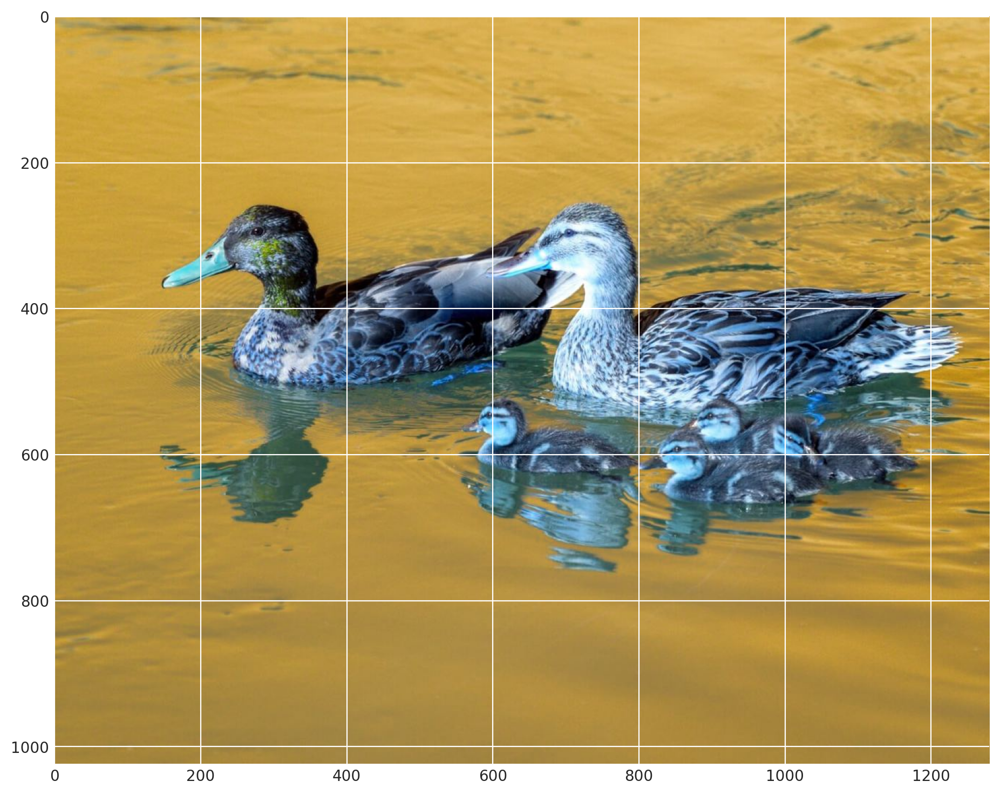

In [269]:
import cv2

image_duck = cv2.imread("duck.jpg")
plt.imshow(image_duck)

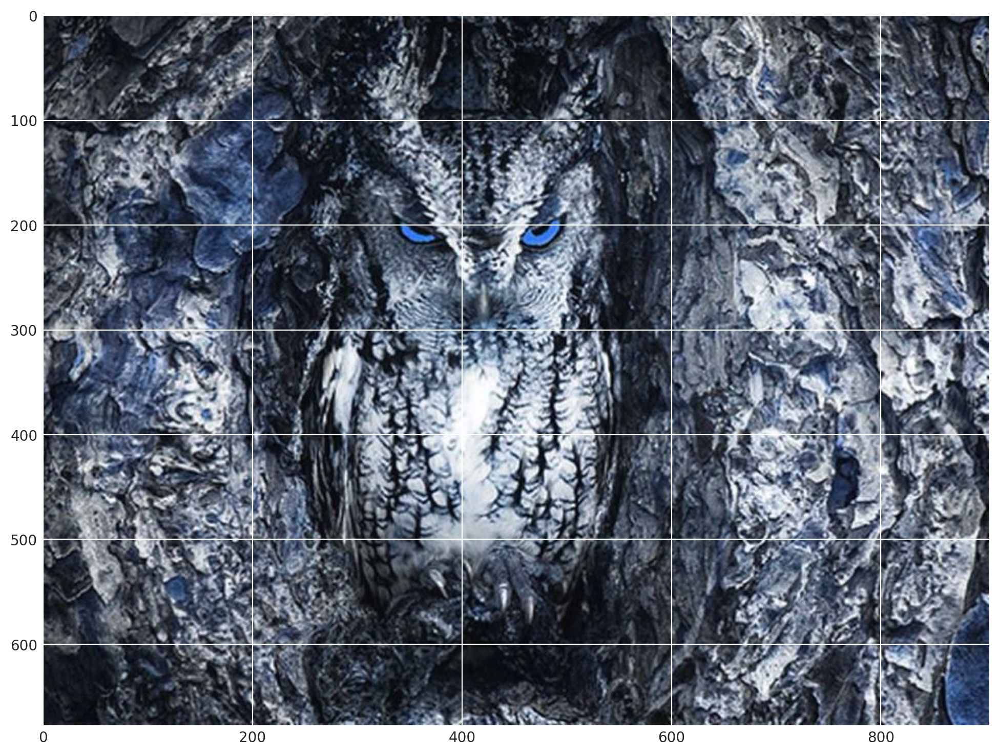

In [270]:
image_owls = cv2.imread("owls.jpg")
plt.imshow(image_owls)

### Задание 2.1 (1.5 балла)
Для каждого изображения, используя кластеризацию ```KMeans```, выделите компоненты, охарактеризовав каждый пиксель следующим образом: $\psi_i = [\lambda x_i, \lambda y_i, r_i, g_i, b_i]$, где 
$x_i$ и $y_i$ — координаты пикселя, $r_i, g_i, b_i$ — его цвет, $\lambda$ — параметр, выражающий важность пространственной связности перед цветовой похожестью.

Примените полученную функцию, взяв следующие $\lambda$: 0.3 и 1.5 для ```duck.jpg``` и ```owls.jpg``` (или другие, но тогда с вас красивые результаты :) )

Число кластеров подберите разумным образом на свой вкус (в качестве нулевого приближения можно взять 3)

In [271]:
def find_components(image, lmbd, n_clusters, title):
    width, height, channels = image.shape
    print(image.shape)
    data = image.reshape(image.shape[0] * image.shape[1], 3)
    pixel_characteristics = np.empty((data.shape[0], 5), dtype=float)

    for i in range(data.shape[0]):
        x = i % width
        y = int(i / width)
        pixel_characteristics[i] = [lmbd * x, lmbd * y, data[i][0], data[i][1], data[i][2]]
    
    kmeans = KMeans(n_clusters=n_clusters, random_state=RANDOM_STATE, n_init=100)
    kmeans.fit(pixel_characteristics)
    labels = kmeans.labels_
    
    labels = labels.reshape(image.shape[0], image.shape[1], 1)

    plt.figure(figsize = (15,8))
    plt.imshow(image, cmap=plt.cm.gray)
    
    for l in range(n_clusters):
        lines = (labels == l)
        lines = lines[:, :, 0]
        plt.contour(lines, contours = 1, colors=[plt.cm.Spectral(l / float(n_clusters))])
    
    plt.xticks(())
    plt.yticks(())
    plt.title(title)
    plt.show()

### Задание 2.2 (1.5 балла)
Попробуйте выделить сегменты при помощи [спектральной кластеризации](http://scikit-learn.org/stable/modules/clustering.html#spectral-clustering). Обратите внимание на [пример в sklearn](http://scikit-learn.org/0.16/auto_examples/cluster/plot_lena_segmentation.html). Для ускорения работы алгоритма рекомендуется привести изображение к серому цвету. При необходимости можно сжать изображения в 2 раза.

Подсказка: ```skimage``` с его ```color``` и ```transform``` в этом помогут :)

Или же воспользуйтесь аналогичными средствами ```PIL``` или ```cv2``` 

In [299]:
from sklearn.cluster import spectral_clustering
from sklearn.feature_extraction import image as image_lib
from PIL import Image

def spectral_segmentation(image, beta, eps, n_clusters):
    try:
        image = image[::2, ::2] + image[1::2, ::2] + image[::2, 1::2] + image[1::2, 1::2]
        image = image[::2, ::2] + image[1::2, ::2] + image[::2, 1::2] + image[1::2, 1::2]
    except:
        print("Downsizing failed, let's try to work with the original image.")
    
    graph = image_lib.img_to_graph(image)
    graph.data = np.exp(-beta * graph.data / image.std()) + eps
    
    start = time.time()
    labels = spectral_clustering(graph, n_clusters=n_clusters,
                                 assign_labels='discretize',
                                 random_state=RANDOM_STATE)
    end = time.time()
    labels = labels.reshape(image.shape)
    print(labels.shape)

    plt.figure(figsize = (15,8))
    plt.imshow(image)
    
    for l in range(n_clusters):
        plt.contour(labels == l, colors=[plt.cm.Spectral(l / float(n_clusters))])
    
    plt.xticks(())
    plt.yticks(())
    plt.title('Spectral clustering: %s, %.2fs' % ('', (end - start)))
    plt.show()

### Задание 2.3 (0.9 баллов)
Визуализируйте результаты сегментации (аналогично рисунку в начале задания 2) для обоих методов.

(1024, 1280, 3)


C:\Users\grace\AppData\Local\Temp\ipykernel_17840\2920657059.py:24: UserWarning: The following kwargs were not used by contour: 'contours'
  plt.contour(lines, contours = 1, colors=[plt.cm.Spectral(l / float(n_clusters))])


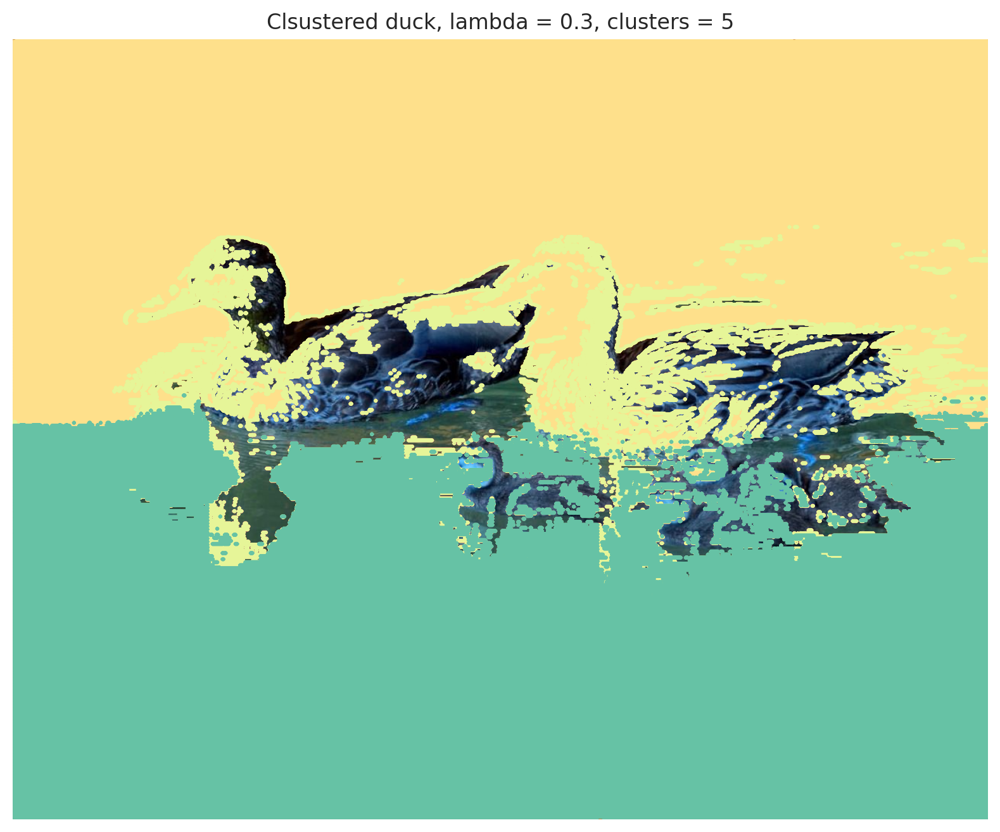

(1024, 1280, 3)


C:\Users\grace\AppData\Local\Temp\ipykernel_17840\2920657059.py:24: UserWarning: The following kwargs were not used by contour: 'contours'
  plt.contour(lines, contours = 1, colors=[plt.cm.Spectral(l / float(n_clusters))])


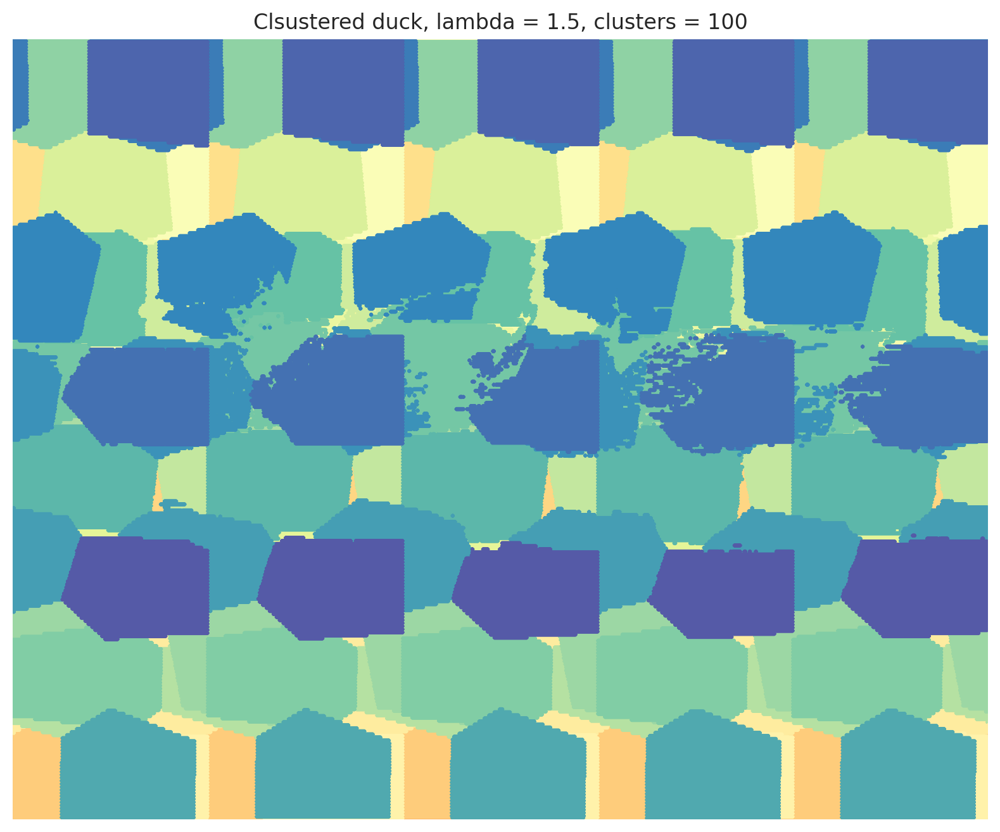

(678, 904, 3)


C:\Users\grace\AppData\Local\Temp\ipykernel_17840\2920657059.py:24: UserWarning: The following kwargs were not used by contour: 'contours'
  plt.contour(lines, contours = 1, colors=[plt.cm.Spectral(l / float(n_clusters))])


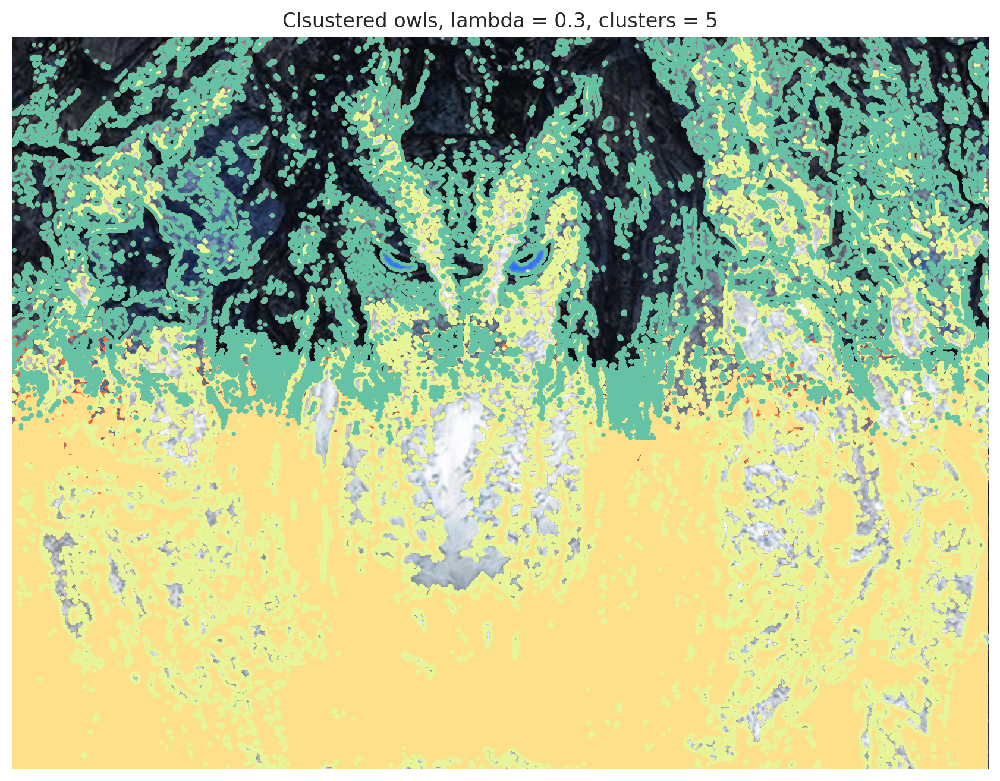

(678, 904, 3)


C:\Users\grace\AppData\Local\Temp\ipykernel_17840\2920657059.py:24: UserWarning: The following kwargs were not used by contour: 'contours'
  plt.contour(lines, contours = 1, colors=[plt.cm.Spectral(l / float(n_clusters))])


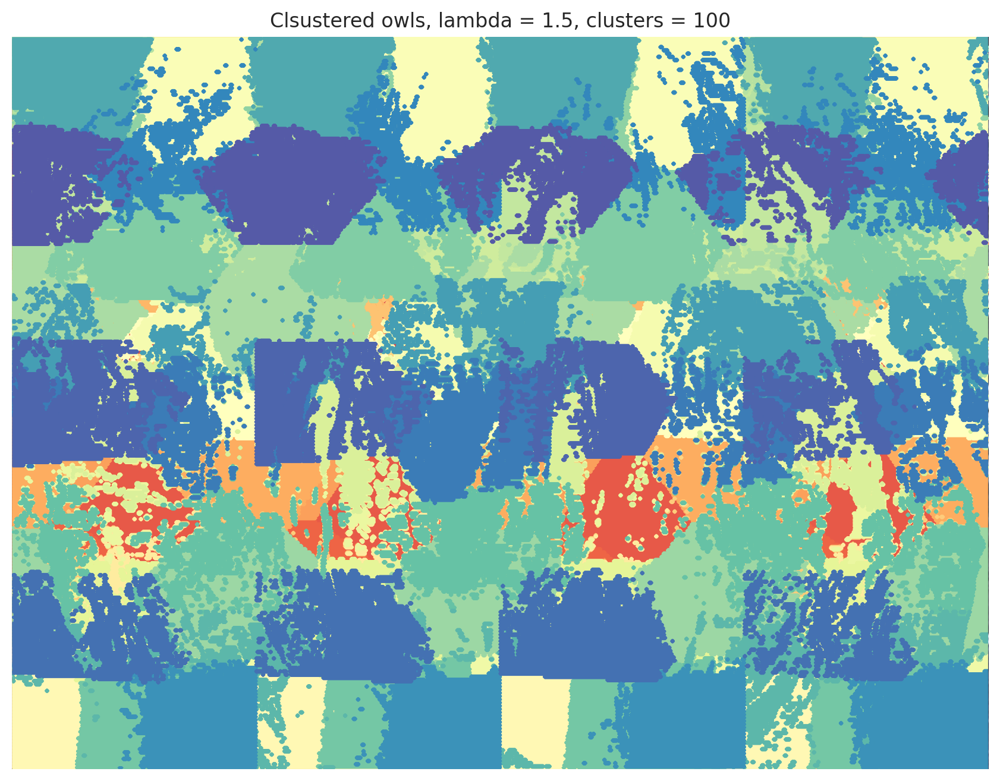

In [273]:
find_components(image_duck, 0.3, 5, "Clsustered duck, lambda = 0.3, clusters = 5")
find_components(image_duck, 1.5, 50, "Clsustered duck, lambda = 1.5, clusters = 100")

find_components(image_owls, 0.3, 5, "Clsustered owls, lambda = 0.3, clusters = 5")
find_components(image_owls, 1.5, 50, "Clsustered owls, lambda = 1.5, clusters = 100")

(256, 320)


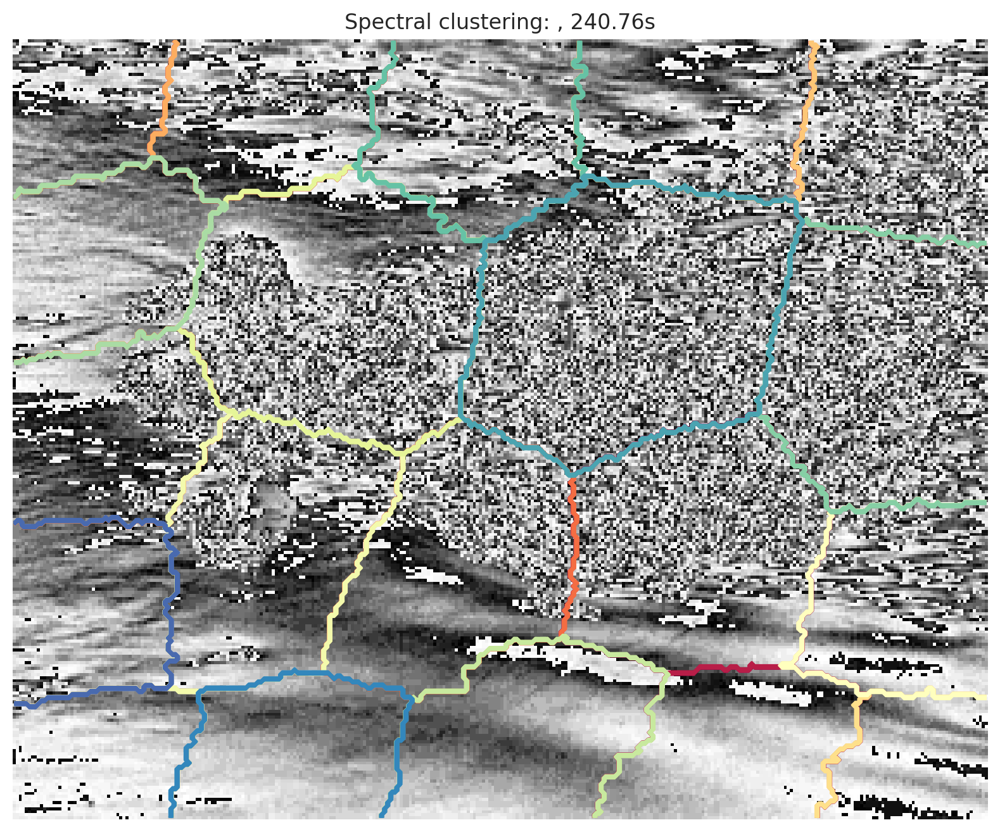

In [301]:
bw_duck = Image.open('duck.jpg').convert('L')
bw_duck = np.array(bw_duck)
spectral_segmentation(bw_duck, 1.2, 1e-6, 20)

Downsizing failed, let's try to work with the original image.
(339, 452)


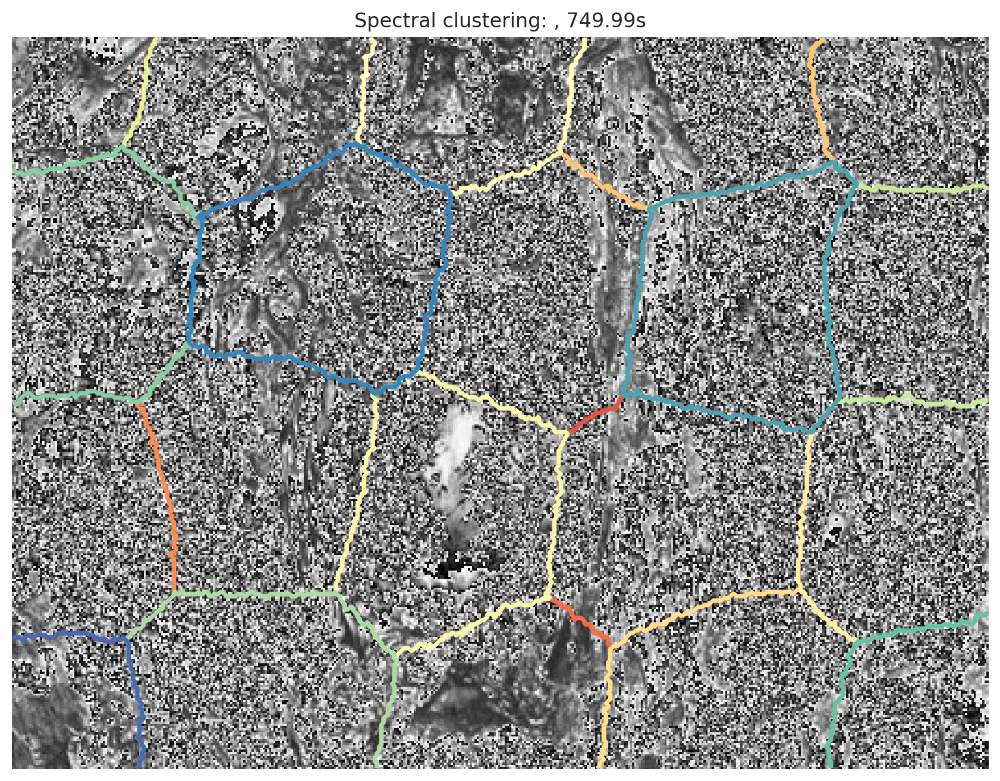

In [289]:
bw_owls = Image.open('owls.jpg').convert('L')
bw_owls = np.array(bw_owls)
spectral_segmentation(bw_owls, 1.2, 0, 20)

### Задание 2.4 (1 балл)
Найдите интересную картинку милого животного и примените алгоритмы и к ней. Поэкспериментируйте с параметрами алгоритмов. Картинку нужно будет загрузить вместе с работой. Слишком большие лучше не брать - считаться будет долго. Не забудьте визуализировать!

Сравните два подхода и сегментации, к которым они приводят.
Для всех ли изображений в результате сегментации хорошо видны контуры объектов?

(1080, 1920, 3)


C:\Users\grace\AppData\Local\Temp\ipykernel_17840\2920657059.py:24: UserWarning: The following kwargs were not used by contour: 'contours'
  plt.contour(lines, contours = 1, colors=[plt.cm.Spectral(l / float(n_clusters))])


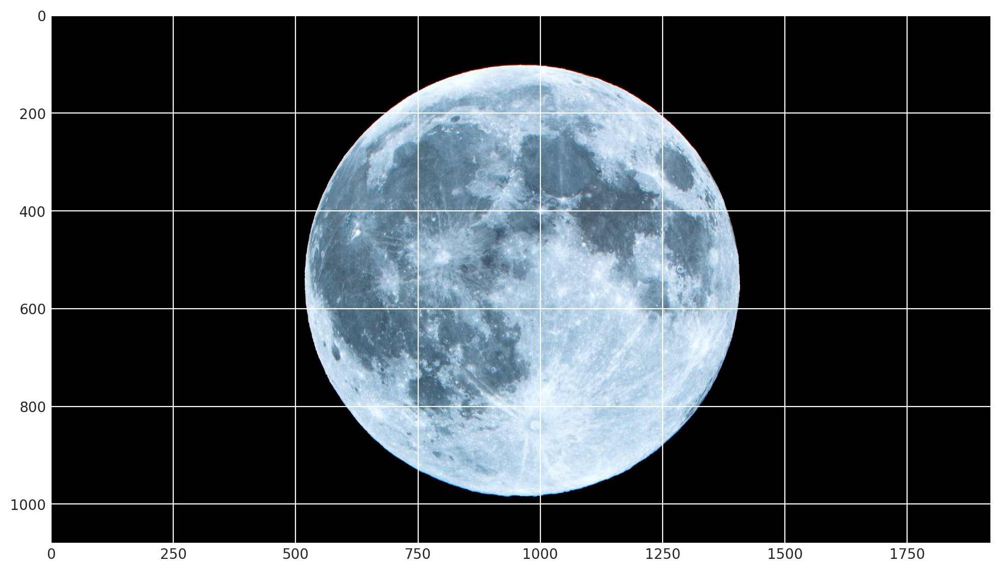

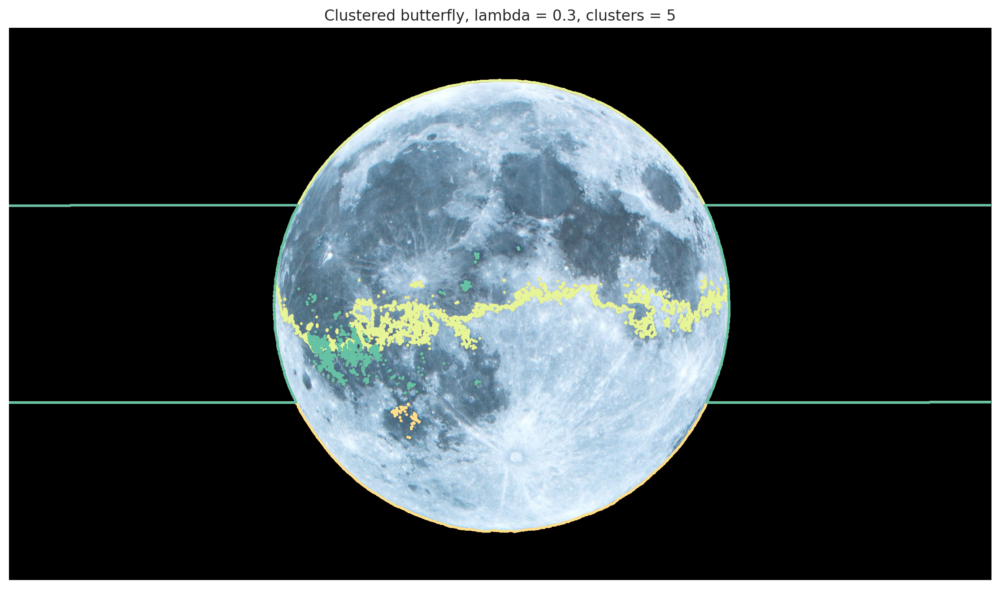

In [305]:
image_moon = cv2.imread("moon.jpg")
plt.imshow(image_moon)

find_components(image_moon, 0.3, 5, "Clustered moon, lambda = 0.3, clusters = 5")

(270, 480)


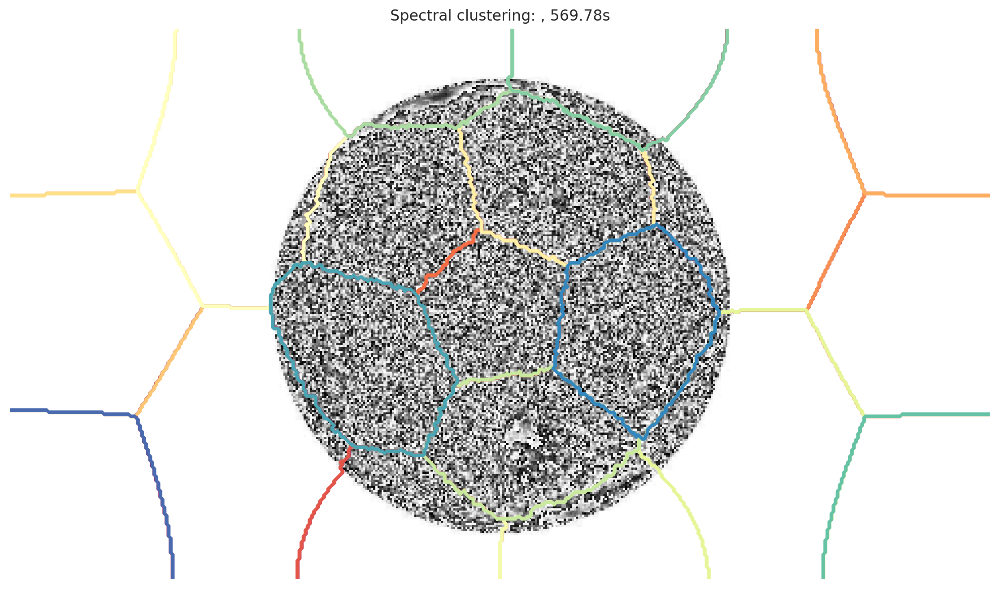

In [308]:
bw_moon = Image.open('moon.jpg').convert('L')
bw_moon = np.array(bw_moon)
spectral_segmentation(bw_moon, 1.2, 1e-6, 20)

Глядя на примеры, KMeans не сможет эффективно сгруппировать разделенные кластеры, даже если количество кластеров известно алгоритму.

Это связано с тем, что KMeans идеально подходят для обнаружения "шаровых" скоплений, где все члены каждого скопления находятся в непосредственной близости друг от друга (в евклидовом смысле).

# Акция
Повеселите проверяющего и вставьте смешной мем. Вдруг повысят балл! Или разместите ваше сообщение о продаже гаража здесь.

[Методичка по мемам](https://www.youtube.com/watch?v=dQw4w9WgXcQ)

https://www.youtube.com/watch?v=sYa5B3X0l44